In [1]:
# Load Extension for noTeXbook theme
%load_ext notexbook

In [2]:
# Enable noTeXbook theme
%texify

<span class="badges">

[![myBinder](https://mybinder.org/badge_logo.svg)](https://mybinder.org/v2/gh/leriomaggio/pytorch-beautiful-ml-data/pydata-global/?filepath=5_case_study/case_study_digital_pathology.ipynb)
    
[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/leriomaggio/pytorch-beautiful-ml-data/blob/pydata-global/5_case_study/case_study_digital_pathology.ipynb)

[![nbviewer](https://raw.githubusercontent.com/jupyter/design/master/logos/Badges/nbviewer_badge.svg)](https://nbviewer.jupyter.org/github/leriomaggio/pytorch-beautiful-ml-data/blob/pydata-global/5_case_study/case_study_digital_pathology.ipynb)
</span>

<span class="fn"><i>[Note]: </i> This notebook has been designed using the [$\text{no}\TeX\text{book}$](https://github.com/leriomaggio/notexbook-jupyter-theme) Jupyter notebook theme. <br />
Please **Trust** the notebook to automatically enable the theme. If you are viewing this notebook in **Google Colab**, these are the [instructions](https://github.com/leriomaggio/notexbook-jupyter-theme/tree/texbook-colab) to enable the theme in Colab.

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Context" data-toc-modified-id="Context-1">Context</a></span></li><li><span><a href="#The-Data" data-toc-modified-id="The-Data-2">The Data</a></span></li><li><span><a href="#Goal" data-toc-modified-id="Goal-3">Goal</a></span><ul class="toc-item"><li><span><a href="#Last-Caveat-before-to-start..." data-toc-modified-id="Last-Caveat-before-to-start...-3.1">Last Caveat before to start...</a></span></li></ul></li><li><span><a href="#1.-Load-Image-and-Annotations" data-toc-modified-id="1.-Load-Image-and-Annotations-4">1. Load Image and Annotations</a></span><ul class="toc-item"><li><span><a href="#Sample-data" data-toc-modified-id="Sample-data-4.1">Sample data</a></span></li><li><span><a href="#Data-Abstractions" data-toc-modified-id="Data-Abstractions-4.2">Data Abstractions</a></span></li><li><span><a href="#Working-on-Tiles" data-toc-modified-id="Working-on-Tiles-4.3">Working on Tiles</a></span><ul class="toc-item"><li><span><a href="#Tiles" data-toc-modified-id="Tiles-4.3.0.1">Tiles</a></span></li><li><span><a href="#Annotation" data-toc-modified-id="Annotation-4.3.1">Annotation</a></span></li><li><span><a href="#Visualise-Annotation" data-toc-modified-id="Visualise-Annotation-4.3.2">Visualise Annotation</a></span><ul class="toc-item"><li><span><a href="#Visualise-all-Bounding-Boxes" data-toc-modified-id="Visualise-all-Bounding-Boxes-4.3.2.1">Visualise all Bounding Boxes</a></span></li></ul></li></ul></li><li><span><a href="#Identify-Tiles-for-Annotations" data-toc-modified-id="Identify-Tiles-for-Annotations-4.4">Identify Tiles for Annotations</a></span><ul class="toc-item"><li><span><a href="#Plot-Rescaled-Annotations" data-toc-modified-id="Plot-Rescaled-Annotations-4.4.1">Plot Rescaled Annotations</a></span><ul class="toc-item"><li><span><a href="#Rescaled-Regions" data-toc-modified-id="Rescaled-Regions-4.4.1.1">Rescaled Regions</a></span></li><li><span><a href="#Rescaled-Bounding-Boxes" data-toc-modified-id="Rescaled-Bounding-Boxes-4.4.1.2">Rescaled Bounding Boxes</a></span></li></ul></li></ul></li><li><span><a href="#Exercise" data-toc-modified-id="Exercise-4.5">Exercise</a></span></li></ul></li><li><span><a href="#Torch-Dataset" data-toc-modified-id="Torch-Dataset-5">Torch Dataset</a></span><ul class="toc-item"><li><span><a href="#Tiling-as-a-Transformer" data-toc-modified-id="Tiling-as-a-Transformer-5.1">Tiling as a Transformer</a></span></li></ul></li></ul></div>

# Generalised Nuclear Segmentation in Histological Images

## Context

![tissues](https://nucleisegmentationbenchmark.weebly.com/uploads/8/7/8/4/87844476/background-images/308046099.png)

**Nuclear segmentation** in digital microscopic tissue images can enable extraction of high quality features for nuclear morphometric and other analyses in [digital pathology](https://en.wikipedia.org/wiki/Digital_pathology). 

However, _conventional_ image processing techniques such as [**Otsu**](https://en.wikipedia.org/wiki/Otsu's_method) ([`skimage.filters.threshold_otsu`](https://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.threshold_otsu)) and [**Watershed**](https://en.wikipedia.org/wiki/Watershed_(image_processing)) ([`skimage.segmentation.watershed`](https://scikit-image.org/docs/dev/api/skimage.segmentation.html#skimage.segmentation.watershed)) segmentation methods do not work effectively on challenging cases such as chromatin-sparse and crowded nuclei. In contrast, Deep learning-based segmentation techniques are able to generalize over nuclear appearances. 

**More information**: 

_A Dataset and a Technique for Generalized Nuclear
Segmentation for Computational Pathology_ ([Paper](https://drive.google.com/file/d/0ByERBiBsEbuTOEJISEpwSkR0SlE/view))

## The Data 

The full dataset we will consider has been released as part of challenge organised in [MICCAI 2018](https://link.springer.com/conference/miccai) (Medical Images Computing and Computer Assisted Intervention).

More information about the dataset for the [challenge](https://monuseg.grand-challenge.org/) can be found [here](https://monuseg.grand-challenge.org/Data/).

The full set of `30` images, and corresponding annotations can be downloaded here: 
- [tissue images](https://drive.google.com/file/d/1--HpxO9tMwkIBnZL0JUqGzO9SRute98W/view)
- [annotations](https://drive.google.com/open?id=0ByERBiBsEbuTTFhTelhiMGhrNkE)

I personally encourage to acquire the full dataset for a more complete processing of what will be presented in this notebook. 

However, given the scope (and the amount of bandwidth and storage required to download the full dataset) <ins>we will limit our study to 2 images, and their annotations</ins>.


## Goal

In this notebook, I wish to demonstrate how good **data abstractions** can lead the way to an easy way to handle _complex_ data (as in this case study).

As you might probably expect, these abstractions will strongly build on the flexibility of **Python** [Data model](https://docs.python.org/3/reference/datamodel.htm) and the new [`dataclasses`](https://docs.python.org/3.7/library/dataclasses.html).

We will also see how these abstractions can support an easy data transformations (this time for both _samples_ and _labels_) to leverage on existing pre-trained **PyTorch** [`torchvision.models`](https://pytorch.org/docs/stable/torchvision/models.html) models for Image Segmentation.

### Last Caveat before to start...

In this notebook, as it has been for the whole tutorial, we will stop at the stage immediately before model training/validation. One of the main reason is that we will avoid any burden required for high-scale DL training computation.

The whole goal of this tutorial is exactly to work on abstractions to ease that step as much as possible, while also remain Pythonic!

However, in this particular case, we are about to work with **High-Resolution** images, that would also require a good amount of computational power also in data preparation. 

For this reason, we will limit our analysis to just 2 single images, instead of the whole dataset 🙃

---

## 1. Load Image and Annotations

### Sample data

Sample data are available at [this](https://www.dropbox.com/s/b7bebd1e4n8f6lq/case-study.tar.gz?dl=1) Dropbox link.

It is possible to download the data using the following two cells

In [3]:
from torchvision.datasets.utils import download_and_extract_archive

In [4]:
DATA_URL = "https://www.dropbox.com/s/6esdp47ilj1qefv/case_study.zip?dl=1"
MD5 = "2d2106c9e0d2b36b97ca49582f7418ce"
DOWNLOAD_ROOT = "."

In [5]:
download_and_extract_archive(url=DATA_URL, download_root=DOWNLOAD_ROOT, 
                             filename="case_study.zip", md5=MD5)

Extracting ./case_study.zip to .


In [6]:
!rm -Rf ./__MACOSX/

In [7]:
import os 
os.listdir("./case_study")

['TCGA-21-5784-01Z-00-DX1.xml',
 'TCGA-18-5592-01Z-00-DX1.tif',
 'TCGA-21-5784-01Z-00-DX1.tif',
 'TCGA-18-5592-01Z-00-DX1.xml']

Let's crack on with opening data and processing annotations, then!

In [8]:
from pathlib import Path
from PIL import Image

DATA_FOLDER = Path("./case_study")

IMG_FILEPATH = DATA_FOLDER / "TCGA-18-5592-01Z-00-DX1.tif"
ANN_FILEPATH = Path(str(IMG_FILEPATH).replace(".tif", ".xml"))

In [9]:
IMG_FILEPATH, ANN_FILEPATH

(PosixPath('case_study/TCGA-18-5592-01Z-00-DX1.tif'),
 PosixPath('case_study/TCGA-18-5592-01Z-00-DX1.xml'))

In [10]:
img = Image.open(IMG_FILEPATH)

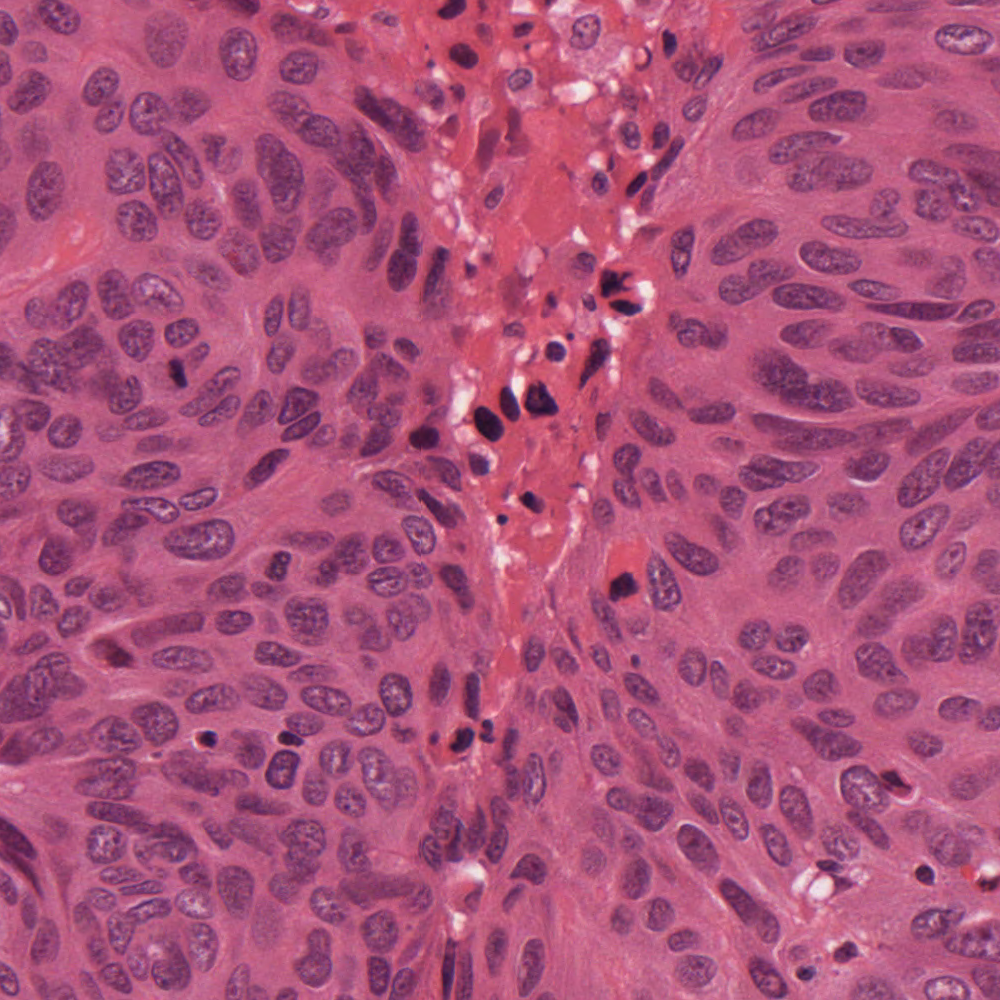

In [11]:
img

Let's take a look at the annotation `XML` file

In [12]:
!head -n 30 case_study/TCGA-18-5592-01Z-00-DX1.xml

<Annotations MicronsPerPixel="0.252000">
	<Annotation Id="1" Name="" ReadOnly="0" NameReadOnly="0" LineColorReadOnly="0" Incremental="0" Type="4" LineColor="65280" Visible="1" Selected="1" MarkupImagePath="" MacroName="">
		<Attributes>
			<Attribute Name="Description" Id="0" Value=""/>
		</Attributes>
		<Regions>
			<RegionAttributeHeaders>
				<AttributeHeader Id="9999" Name="Region" ColumnWidth="-1"/>
				<AttributeHeader Id="9997" Name="Length" ColumnWidth="-1"/>
				<AttributeHeader Id="9996" Name="Area" ColumnWidth="-1"/>
				<AttributeHeader Id="9998" Name="Text" ColumnWidth="-1"/>
				<AttributeHeader Id="1" Name="Description" ColumnWidth="-1"/>
			</RegionAttributeHeaders>
			<Region Id="2" Type="0" Zoom="5" Selected="0" ImageLocation="" ImageFocus="0" Length="126.0" Area="1049.3" LengthMicrons="31.8" AreaMicrons="66.6" Text="" NegativeROA="0" InputRegionId="0" Analyze="1" DisplayId="2">
				<Attributes/>
				<Vertices>
					<Vertex X="96.400000" Y="70.800000"/>
					<Vertex X

As we can see, we have the `main` tag (`Annotation`) which contains many `Regions`. Each `Region` has attributes, and a (very long) series of `Vertex` (i.e. `Point`).

A single `Region` correspond to a single annotation (with a unique `id`), composed by a sequence of  (`x`,`y`) pairs of coordinates (i.e. `Vertex`)

To parse the XML file, we will be using the [`xml.etree`](https://docs.python.org/3/library/xml.etree.elementtree.htm) parser included in Python standard library.

In [13]:
import xml.etree.ElementTree as ET

In [14]:
tree = ET.parse(ANN_FILEPATH)
root = tree.getroot()

In [15]:
root.tag

'Annotations'

In [16]:
len(root.findall("Annotation"))

1

So each file contains one single annotation

In [17]:
regions = root.findall("./Annotation/Regions/Region")

In [18]:
len(regions)

480

And this annotations contains `480` annotated regions, each of which will count for a single nucleus.

Let's now collect of of this coordinates, to visualise them on top of the target image:

In [19]:
from matplotlib import pyplot as plt

In [20]:
all_xs, all_ys = list(), list()
for region_tag in regions:
    vertices = region_tag.findall("./Vertices/Vertex")
    for vertex in vertices:
        x, y = float(vertex.get("X")), float(vertex.get("Y"))
        all_xs.append(x)
        all_ys.append(y)

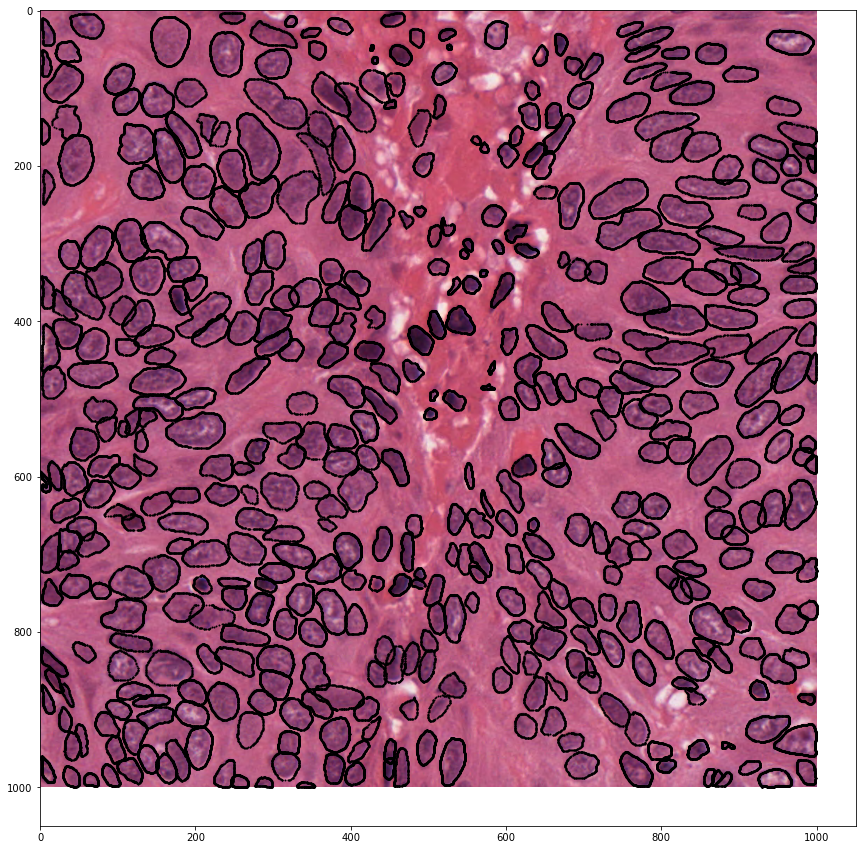

In [21]:
plt.figure(figsize=(15, 15))
plt.imshow(img)
plt.scatter(all_xs, all_ys, c="k", s=1)
plt.show()

**Great**. 

That was good for visualisation... but definitely not for data processing, nonetheless for machine learning!

### Data Abstractions

Let's now to work one step at a time (as usual) all the data abstractions we might want to put in place.

No doubt, we would need either a `Vertex`, presumably a `namedtuple` for easier API field access, and a `Region` class collecting all coordinates for each nucleus.

In [22]:
from collections import namedtuple
from dataclasses import dataclass, field
# we might need to access long lists of coords quite often
# let's leverage on some optimisation with caching!
from functools import lru_cache
import numpy as np

from typing import List, Tuple, Sequence

In [23]:
Vertex = namedtuple("Vertex", ["x", "y"])

In [24]:
@dataclass
class Region:
    rid: str
    vertices: List[Vertex] = field(init=False)
        
    def __post_init__(self):
        self.vertices = list()
        
    def __iadd__(self, point: Tuple[float, float]):
        try:
            x, y = point
            point = Vertex(x,y)
        except ValueError as e:
            raise e
        else:
            self.vertices.append(point)
        return self
    
    def __ilshift__(self, point: Tuple[float, float]):
        # this is more for fun of using <<=
        return self.__iadd__(point)
    
    def __hash__(self) -> int:
        # making hashable to exploit lru_cache of self
        return hash(self.rid)
    
    def __repr__(self): 
        return str(self)
    
    def __str__(self):
        return f"Region({self.rid})"
    
    @property
    @lru_cache(maxsize=None)
    def x_coords(self) -> Sequence[int]:
        return np.asarray([v.x for v in self.vertices])
    
    @property
    @lru_cache(maxsize=None)
    def y_coords(self) -> Sequence[int]:
        return np.asarray([v.y for v in self.vertices])
    
    @property
    @lru_cache(maxsize=None)
    def centroid(self) -> Vertex:
        return Vertex(x=np.mean(self.x_coords), y=np.mean(self.y_coords))
    


Let's now write our function to collect all `Region` instances from XML file

In [25]:
from xml.etree.ElementTree import Element

def collect_regions(regions_tag: List[Element]) -> List[Region]:
    all_regions = list()
    for region_tag in regions_tag:
        rid = region_tag.get("Id")
        region = Region(rid=rid)
        vertices = region_tag.findall("./Vertices/Vertex")
        for vertex in vertices:
            x, y = float(vertex.get("X")), float(vertex.get("Y"))
            region <<= (x, y)
        all_regions.append(region)
    return all_regions

In [26]:
all_regions = collect_regions(regions)

In [27]:
len(all_regions)

480

In [28]:
all_regions[0]

Region(2)

Let's cross-check that everything was collected properly

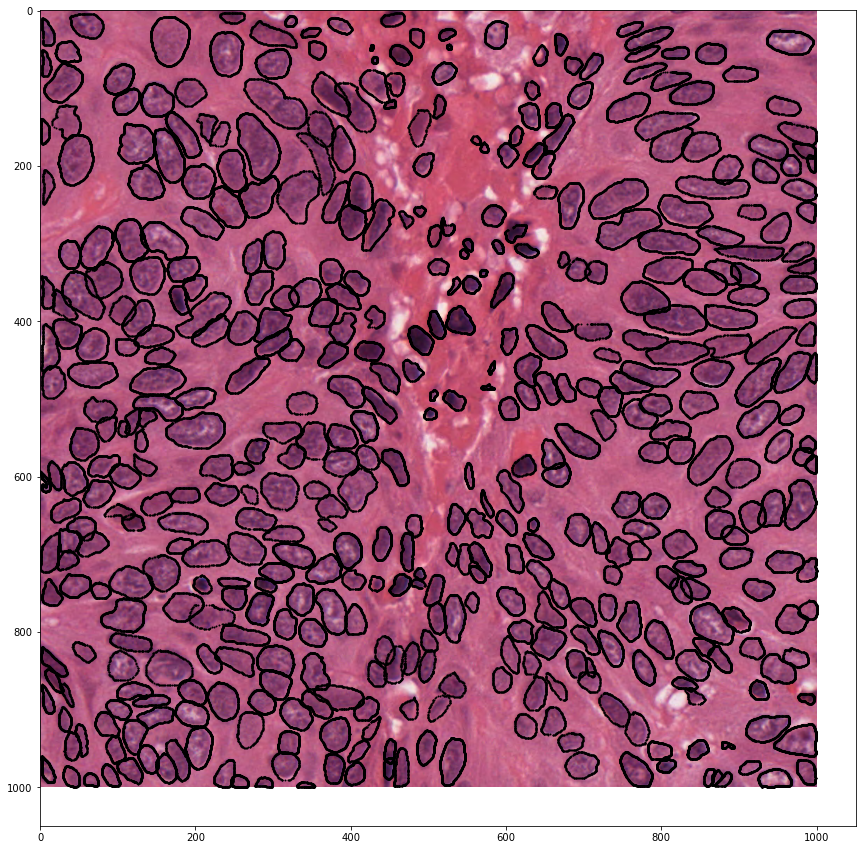

In [29]:
plt.figure(figsize=(15, 15))
plt.imshow(img)
for region in all_regions:
    plt.scatter(region.x_coords, region.y_coords, c="k", s=1)
plt.show()

### Working on Tiles

As it is customary, Deep Learning models processing high-resolution images work on _tiles_ (a.k.a. patches) as either a way to implicitly increase the _size_ of the training set, and to cope with memory constraints imposed by GPU architectures.

Therefore we now need a way to:

1. Crop original images into _tiles_
2. Rescaling annotations accordingly to provide consistent data to DL models

##### Tiles

Let's start by working on the abstraction of a `Tile`. 

For simplicity we will be considering a the input image as cropped into `4` quadrants! There is no loss of generality, neither in the abstraction, nor in the derived conclusions.

A `Quadrant` is a very special case of a general _non-overlapping_ `Tile`, which covers the whole surface of the input image. 
These are all requirements that usually do not apply to _random tiling_.

To generate quadrants, we will be using the `crop` transformer from `torchvision` in its [`functional`](https://pytorch.org/docs/stable/torchvision/transforms.html?highlight=crop#torchvision.transforms.functional.crop) form

In [30]:
from torchvision.transforms.functional import crop

In [31]:
crop_height = crop_width = 500
image_width, image_height = img.width, img.height

tl = crop(img, 0, 0, crop_height, crop_width)
tr = crop(img, 0, image_width - crop_width, crop_height, crop_width)
bl = crop(img, image_height - crop_height, 0, crop_height, crop_width)
br = crop(img, image_height - crop_height, image_width - crop_width, crop_height, crop_width)

In [32]:
quadrants = (tl, tr, bl, br)

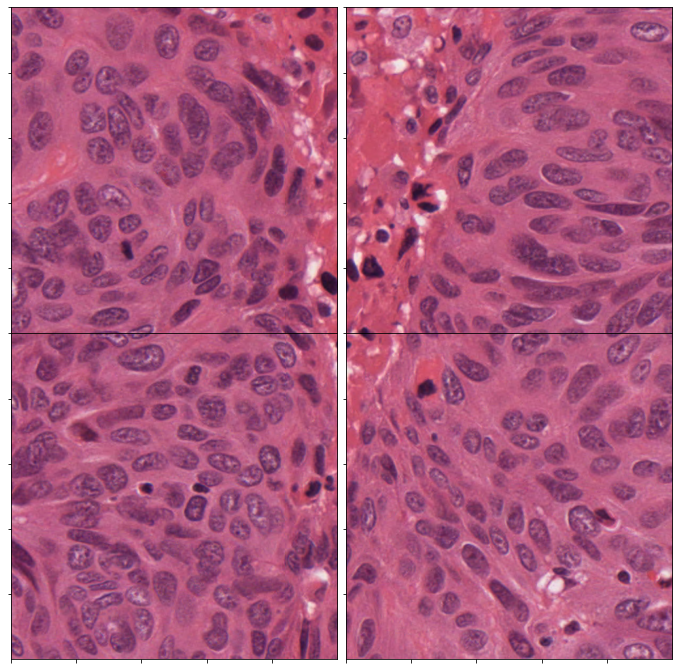

In [33]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))
for i, row in enumerate(axes):
    for j, col in enumerate(row):
        col.imshow(quadrants[(2*i)+j])
        col.set_xticklabels([])
        col.set_yticklabels([])
plt.subplots_adjust(wspace=0.0,hspace=0.0)
plt.show()

So, what would be a tile, in the first place?

1. We would need to identify a single `Tile` by its corner coordinates 
    - (`xmin`, `ymin`, `xmax`, `ymax`)
2. We would need to check efficiently whether a given region is _contained_ into a `Tile`

Incidentally, the first data representation is what is usually referred to **boundin box** (i.e. `BBox`) in standard Image segmentation.

Therefore, our `Tile` abstraction will be a special case of a `BBox` object, with _membership_ test operators.

In [34]:
from matplotlib import patches as ptc  # we want to plt BBox
from __future__ import annotations

import torch
from torchvision.ops.boxes import box_iou  # IOU i.e. Jaccard index

In [35]:
@dataclass
class BBox:
    xmin: float
    ymin: float
    xmax: float
    ymax: float
    
    @property
    def rect(self) -> ptc.Rectangle:
        return ptc.Rectangle((self.xmin, self.ymin), 
                             width=self.width, height=self.height, 
                             facecolor="none", edgecolor="y")
    
    @property
    def vertices(self) -> Tuple[Vertex, Vertex, Vertex, Vertex]:
        """return (tl, tr, bl, br) coordinates of Bbox corners"""
        tl = Vertex(self.xmin, self.ymin)
        tr = Vertex(self.xmax, self.ymin)
        bl = Vertex(self.xmin, self.ymax)
        br = Vertex(self.xmax, self.ymax)
        return (tl, tr, bl, br)
    
    @property
    def width(self) -> float:
        return self.xmax - self.xmin
    
    @property
    def height(self) -> float:
        return self.ymax - self.ymin
    
    @property
    def area(self) -> float:
        return (self.width * self.height) / 2
    
    def to_tuple(self):
        return (self.xmin, self.ymin, self.xmax, self.ymax)
    
    def to_tensor(self):
        """return tensor of size [1, 4] as expected by 
        the `box_iou` function from torchvision"""
        return torch.Tensor([self.to_tuple()])
    
    def __truediv__(self, other: BBox) -> float:
        """return iou of the two bboxes"""
        return box_iou(self.to_tensor(), other.to_tensor())
    
    def __itruediv__(self, other: BBox) -> float:
        """return iou of the two bboxes"""
        return box_iou(self.to_tensor(), other.to_tensor())
    
    def __contains__(self, bbox: BBox) -> bool:
        # bbox division --> iou
        return (bbox / self) > 0
    

In addition to _standard_ `BBox` class container (and variation as `tuple` and `torch.Tensor`), we also added in our abstract the overload for the `__truediv__` operator which implements the **Intersection Over Union** (`IoU`) between pair of bounding boxes. 

The `IoU` [operation](https://www.pyimagesearch.com/2016/11/07/intersection-over-union-iou-for-object-detection/) is common practice for object detection, as it is used also by DL models to filter-out non-matching predictions. 
In fact, we did re-use the `box_iou` implementation included in `torchvision`.

The same operator has been used in the _membership_ test operator to check for overlap between two bounding boxes (for example, generated by a DL model, and the one in the ground truth).

Now time for our `Tile`.

In [36]:
from functools import singledispatchmethod

@dataclass
class Tile(BBox):
    
    label: str = ""  # optional label to identify a quadrant

    @singledispatchmethod
    def __contains__(self, bbox: BBox) -> bool:
        return super(Tile, self).__contains__(bbox)
    
    @__contains__.register
    def _(self, r: Region) -> bool:
        inx = (self.xmin <= r.centroid.x <= self.xmax)
        iny = (self.ymin <= r.centroid.y <= self.ymax)
        return inx and iny
    
    @__contains__.register
    def _(self, v: Vertex) -> bool:
        inx = (self.xmin <= v.x <= self.xmax)
        iny = (self.ymin <= v.y <= self.ymax)
        return inx and iny

So in our design, a `Tile` is no more than a `BBox` with membership test operator overloaded (`in Tile`) using [`singledispatchmethod`](https://docs.python.org/3/library/functools.html#functools.singledispatchmethod)) to allow for membership test of `Region`, `BBox`, and `Vertex`. 

#### Annotation

The latest abstraction we will be defining is `Annotation`, an extension of a `Region` which adds a new `rescale` method, as well as `classmethod` to convert parsed `Region` instances into `Annotation` to allow for rescaling.

In [37]:
@dataclass
class Annotation(Region):
    """Annotation: A rescalable Region"""
    
    @classmethod
    def from_region(cls, region: Region) -> Annotation:
        ann = Annotation(rid=region.rid)
        ann.vertices = region.vertices
        return ann
    
    @property
    @lru_cache(maxsize=None)
    def corners(self) -> Tuple[Vertex, Vertex, Vertex, Vertex]:
        """return a tuple of the 4 corner vertices (tl, tr, bl, br)"""
        bl = min(self.vertices, key=lambda v: v.x)
        tl = min(self.vertices, key=lambda v: v.y)
        tr = max(self.vertices, key=lambda v: v.x)
        br = max(self.vertices, key=lambda v: v.y)
        return (tl, tr, bl, br)
    
    @property
    def bounding_box(self) -> BBox:
        xmin, ymin = np.min(self.x_coords), np.min(self.y_coords)
        xmax, ymax = np.max(self.x_coords), np.max(self.y_coords)
        return BBox(xmin, ymin, xmax, ymax)
    
    def rescale(self, tile: Tile) -> Annotation:
        tile_label = tile.label if len(tile.label) else "quad"
        annotation = Annotation(rid=f"{self.rid}_{tile_label}")
        for v in self.vertices:
            rv_x = np.clip(v.x - tile.xmin, a_min=0, a_max=tile.width)
            rv_y = np.clip(v.y - tile.ymin, a_min=0, a_max=tile.height)
            annotation <<= (rv_x, rv_y)
        return annotation
    
    def __str__(self):
        return f"Annotation({self.rid})"
    
    def __repr__(self):
        return str(self)
    
    def __hash__(self) -> int:
        return super(Annotation, self).__hash__()
    
    

In [38]:
def convert_regions_to_annotations(regions: List[Region]) -> List[Annotation]:
    anns = list()
    for reg in regions:
        anns.append(Annotation.from_region(reg))
    return anns
    

In [39]:
all_annotations = convert_regions_to_annotations(all_regions)

In [40]:
len(all_annotations)     

480

#### Visualise Annotation

In [41]:
annotation = all_annotations[0]

In [42]:
annotation

Annotation(2)

In [43]:
len(annotation.vertices)

453

In [44]:
len(annotation.y_coords)

453

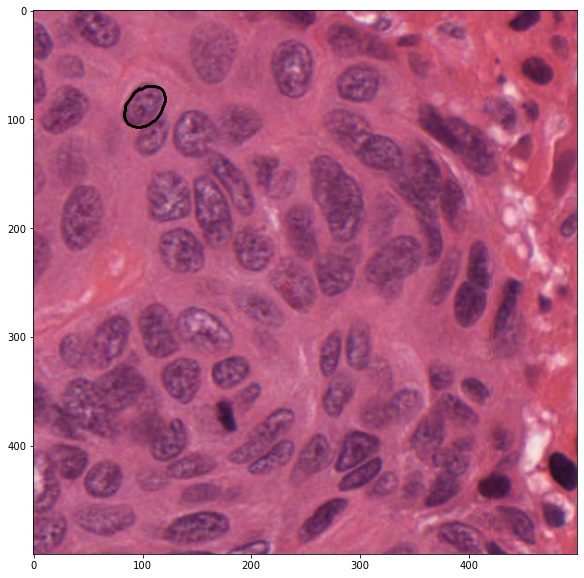

In [45]:
plt.figure(figsize=(10, 10))
plt.imshow(tl)
plt.scatter(annotation.x_coords, annotation.y_coords, c="k", s=1)
plt.show()

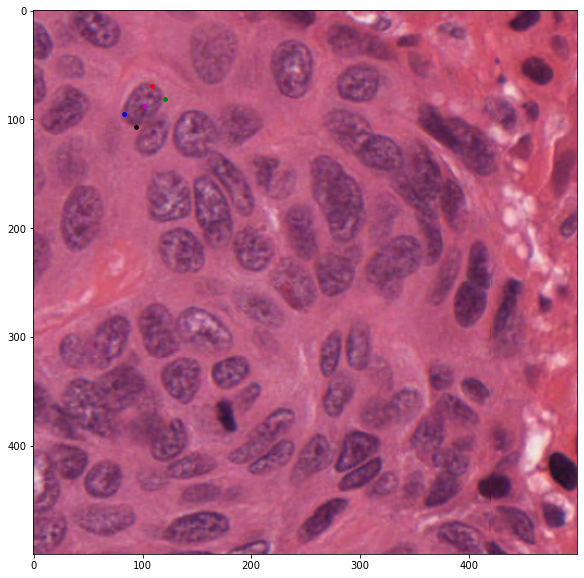

In [46]:
plt.figure(figsize=(10, 10))
plt.imshow(tl)
for v, c in zip(annotation.corners, "rgbk"):
    plt.scatter(*v, c=c, s=14)
plt.scatter(*annotation.centroid, s=14, c="m")
plt.show()

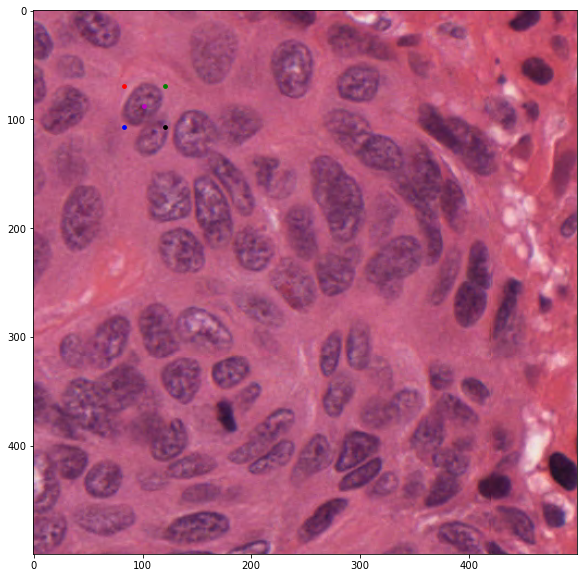

In [47]:
plt.figure(figsize=(10, 10))
plt.imshow(tl)
bbox = annotation.bounding_box
for v, c in zip(bbox.vertices, "rgbk"):
    plt.scatter(*v, c=c, s=14)
plt.scatter(*annotation.centroid, s=14, c="m")
plt.show()

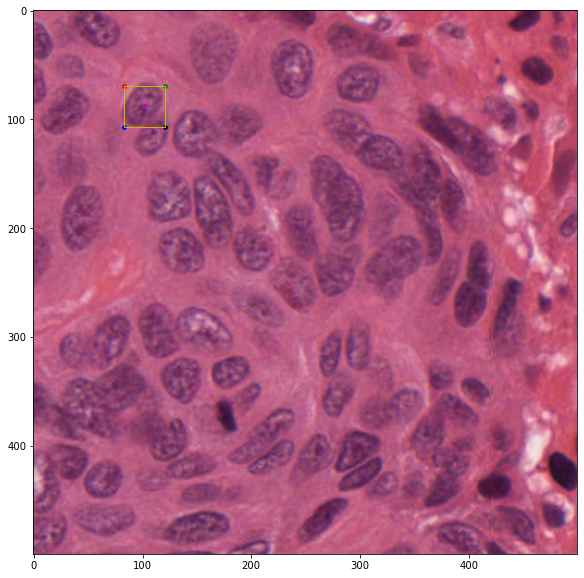

In [48]:
fig, ax = plt.subplots(1, figsize=(10, 10))
ax.imshow(tl)
bbox = annotation.bounding_box
for v, c in zip(bbox.vertices, "rgbk"):
    ax.scatter(*v, c=c, s=14)
ax.scatter(*annotation.centroid, s=14, c="m")
ax.add_patch(bbox.rect)
plt.show()


##### Visualise all Bounding Boxes

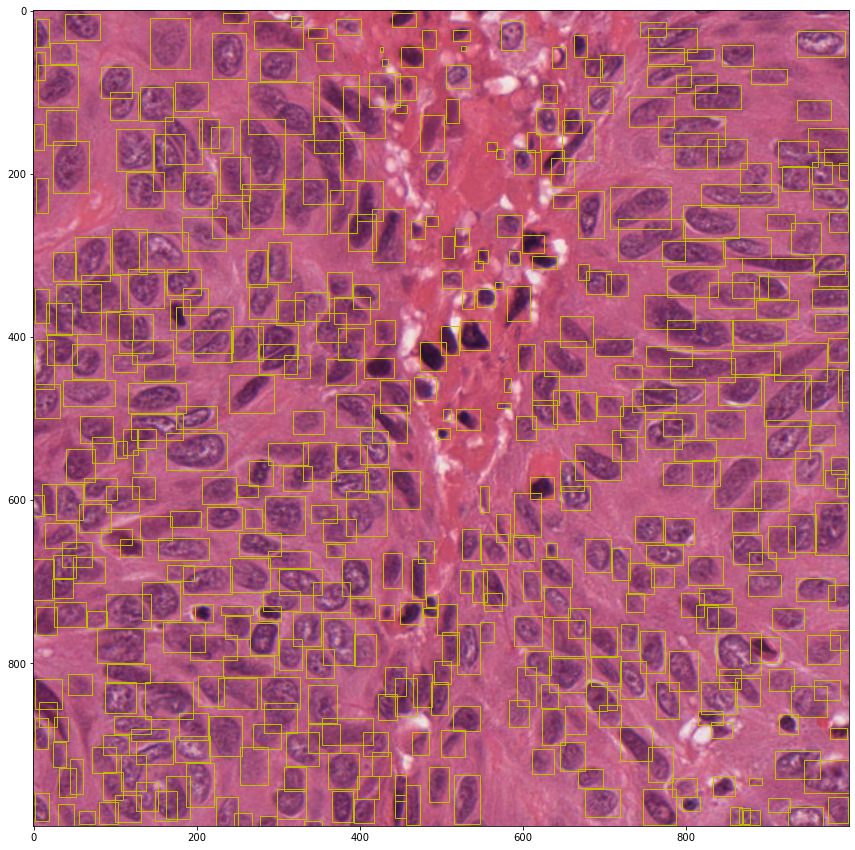

In [49]:
fix, axis = plt.subplots(1, figsize=(15, 15))
axis.imshow(img)
for annotation in all_annotations:
    axis.add_patch(annotation.bounding_box.rect)
plt.show()

### Identify Tiles for Annotations

In [50]:
four_quads = {"tl": Tile(xmin=0, xmax=499, ymin=0, ymax=499, label="tl"), 
              "tr": Tile(xmin=500, xmax=999, ymin=0, ymax=499, label="tr"),
              "bl": Tile(xmin=0, xmax=499, ymin=500, ymax=999, label="bl"),
              "br": Tile(xmin=500, xmax=999, ymin=500, ymax=999, label="br"),
             }

In [51]:
for loc, quadrant in four_quads.items():
    print(f"Annotation in {loc}: {annotation in quadrant}")

Annotation in tl: False
Annotation in tr: False
Annotation in bl: True
Annotation in br: False


In [52]:
for loc, quadrant in four_quads.items():
    bbox = annotation.bounding_box
    print(f"BBox in {loc}: {bbox in quadrant}")

BBox in tl: False
BBox in tr: False
BBox in bl: True
BBox in br: False


In [53]:
def which_quadrant(annotation: Annotation, 
                   quadrants: Dict[str, Quadrant] = four_quads) -> str:
    """Identify the enclosing quadrant for input region"""
    matching_quad = list()
    for quad, quadrant in quadrants.items():
        if annotation in quadrant:
            matching_quad.append(quad)
    if not len(matching_quad):
        return "none-found"
    if len(matching_quad) == 1:
        return matching_quad[0]
    return "multiple"
    

In [54]:
from collections import defaultdict
regions_quadrant = defaultdict(list)
for annotation in all_annotations:
    quad = which_quadrant(annotation)
    regions_quadrant[quad].append(annotation)

In [55]:
regions_quadrant.keys()

dict_keys(['tl', 'tr', 'bl', 'br'])

In [56]:
for k in regions_quadrant:
    print(f"{k}: {len(regions_quadrant[k])}")

tl: 105
tr: 109
bl: 146
br: 120


In [57]:
sum([len(rs) for rs in regions_quadrant.values()])

480

In [58]:
scaled_annotations_per_quad = defaultdict(list)

for quad, annotations in regions_quadrant.items():
    matched_quad = four_quads[quad]
    for ann in annotations:
        scaled_ann = ann.rescale(matched_quad)
        scaled_annotations_per_quad[quad].append(scaled_ann)


In [59]:
len(scaled_annotations_per_quad)

4

In [60]:
scaled_annotations_per_quad.keys()

dict_keys(['tl', 'tr', 'bl', 'br'])

In [61]:
for k in scaled_annotations_per_quad:
    print(f"{k}: {len(scaled_annotations_per_quad[k])}")

tl: 105
tr: 109
bl: 146
br: 120


#### Plot Rescaled Annotations

We are now going to finally plot rescaled regions

##### Rescaled Regions

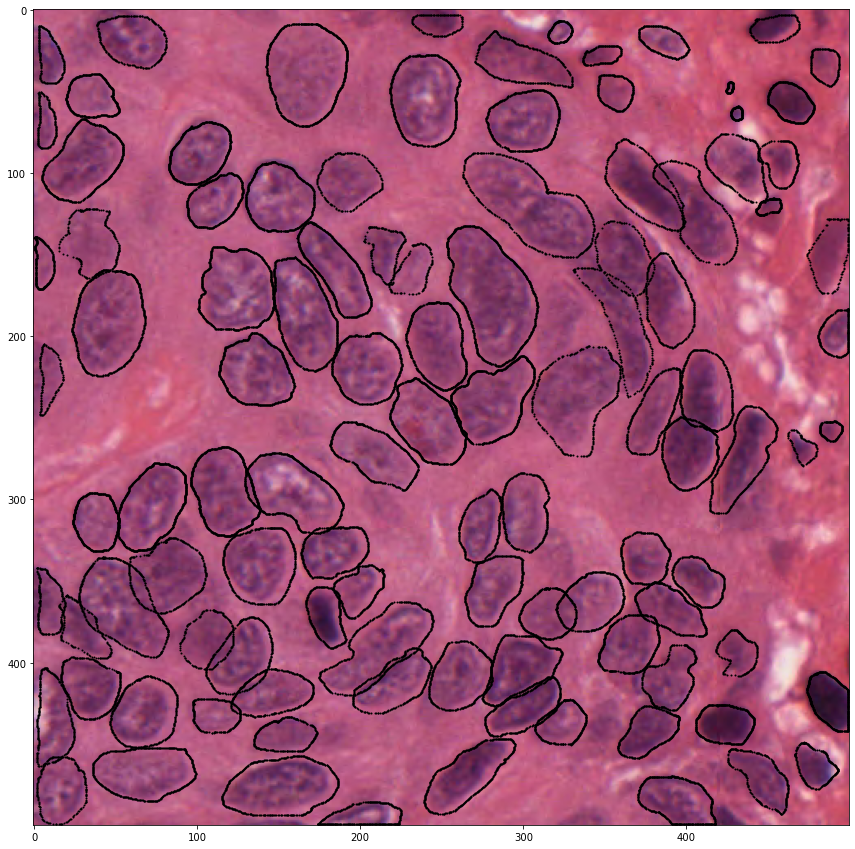

In [62]:
plt.figure(figsize=(15, 15))
plt.imshow(tl)
for reg in scaled_annotations_per_quad["tl"]:
    plt.scatter(reg.x_coords, reg.y_coords, c="k", s=1)
plt.show()

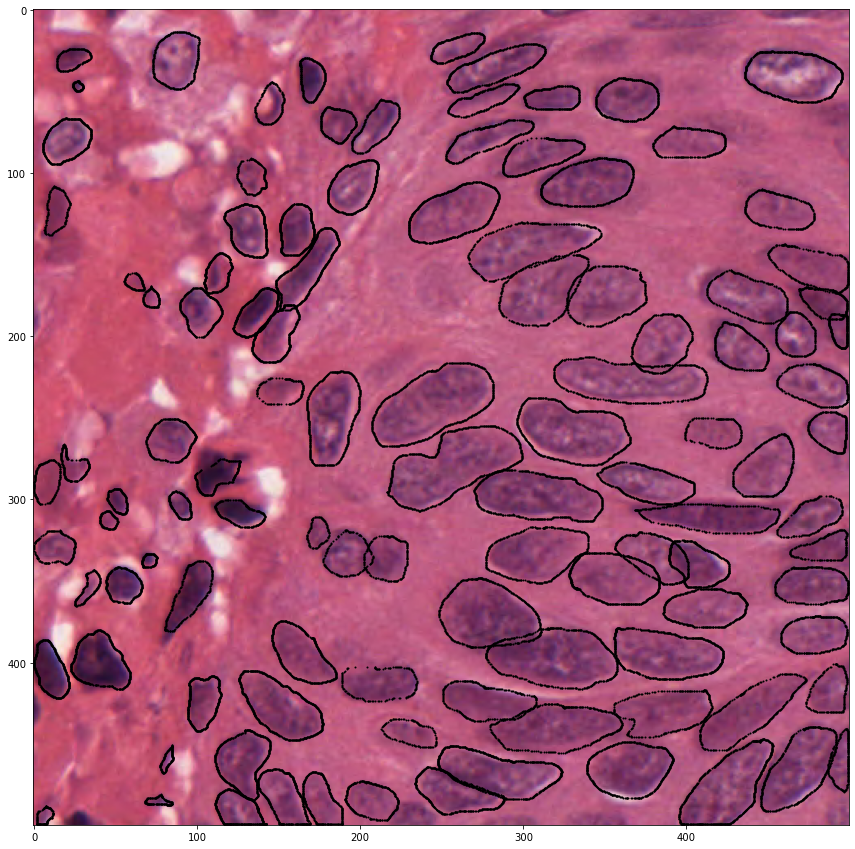

In [63]:
plt.figure(figsize=(15, 15))
plt.imshow(tr)
for reg in scaled_annotations_per_quad["tr"]:
    plt.scatter(reg.x_coords, reg.y_coords, c="k", s=1)
plt.show()

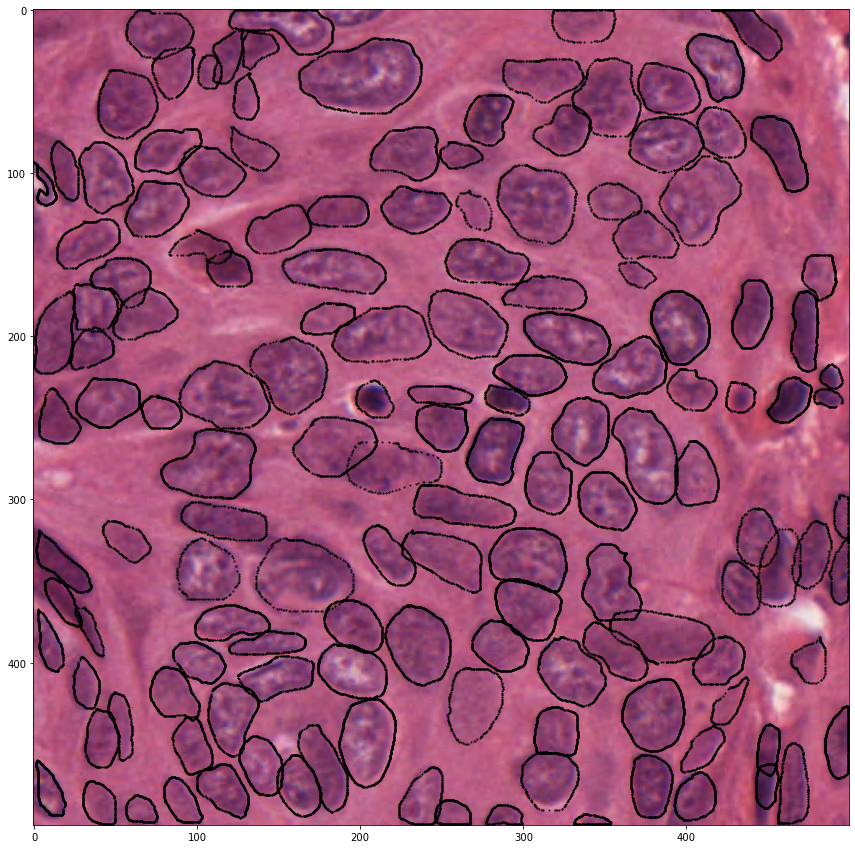

In [64]:
plt.figure(figsize=(15, 15))
plt.imshow(bl)
for reg in scaled_annotations_per_quad["bl"]:
    plt.scatter(reg.x_coords, reg.y_coords, c="k", s=1)
plt.show()

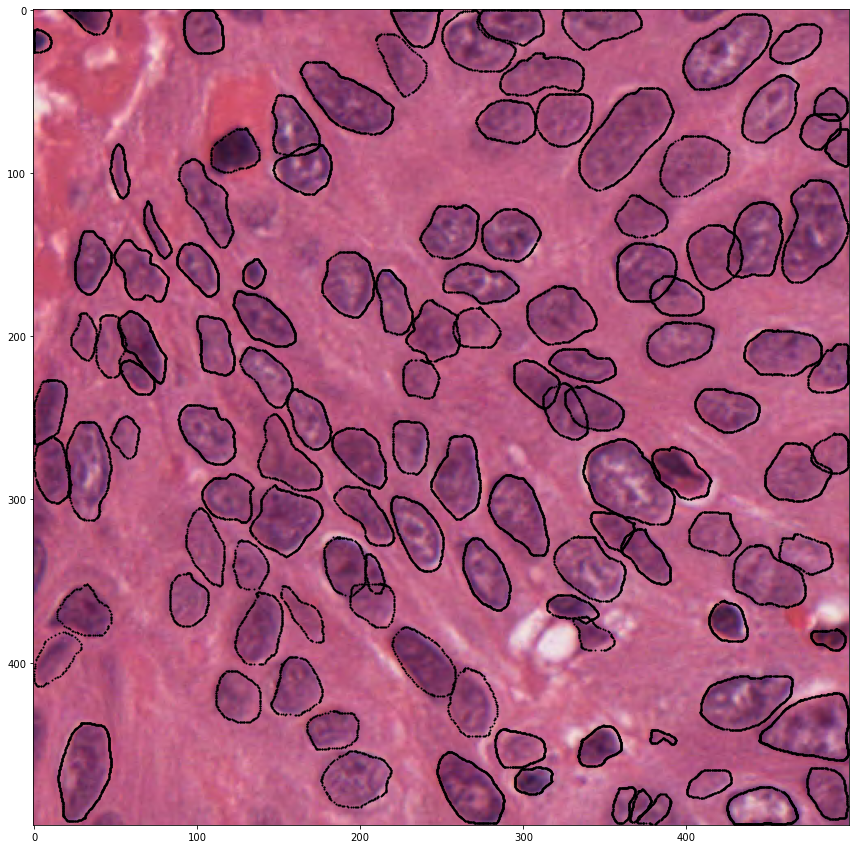

In [65]:
plt.figure(figsize=(15, 15))
plt.imshow(br)
for reg in scaled_annotations_per_quad["br"]:
    plt.scatter(reg.x_coords, reg.y_coords, c="k", s=1)
plt.show()

##### Rescaled Bounding Boxes

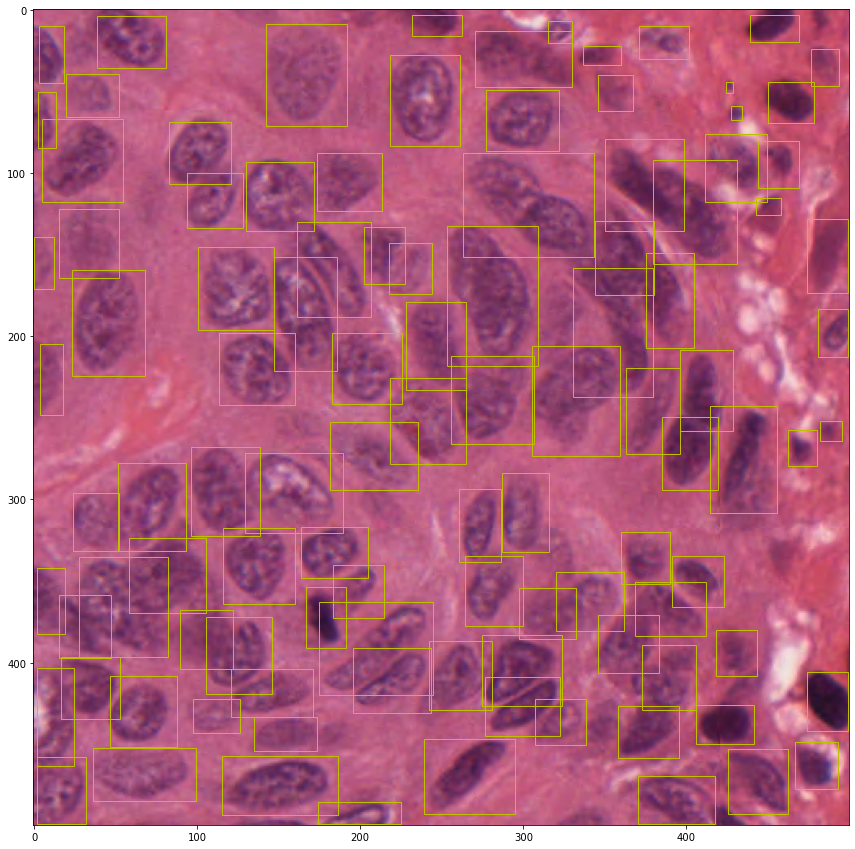

In [66]:
fig, axis = plt.subplots(1, figsize=(15, 15))
plt.imshow(tl)
for reg in scaled_annotations_per_quad["tl"]:
    axis.add_patch(reg.bounding_box.rect)
plt.show()

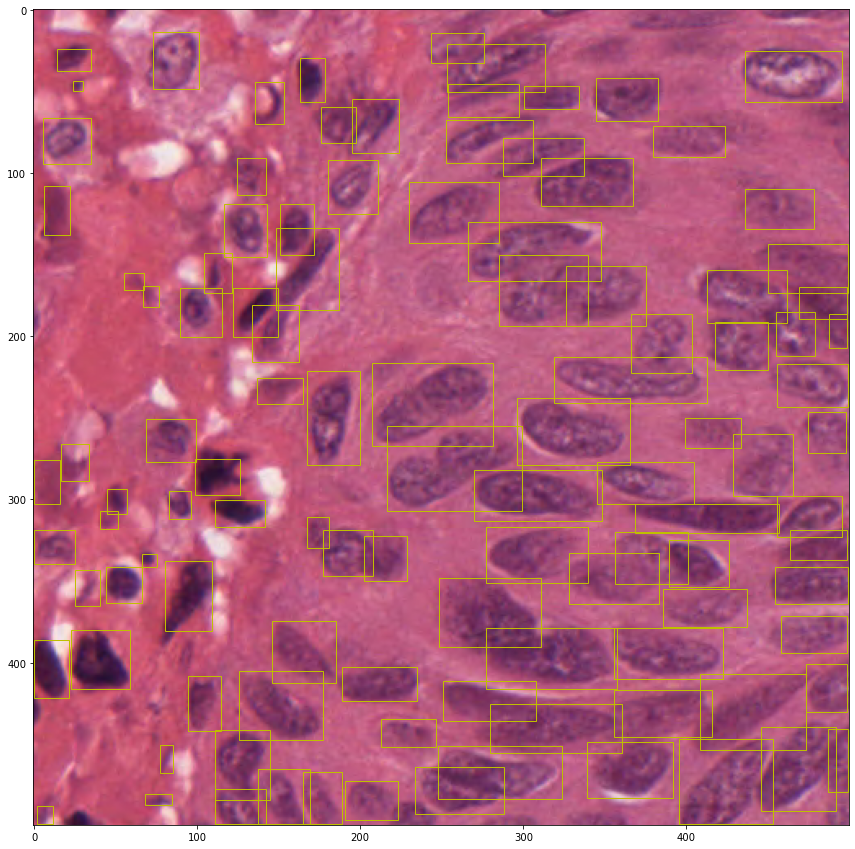

In [67]:
fig, axis = plt.subplots(1, figsize=(15, 15))
plt.imshow(tr)
for reg in scaled_annotations_per_quad["tr"]:
    axis.add_patch(reg.bounding_box.rect)
plt.show()

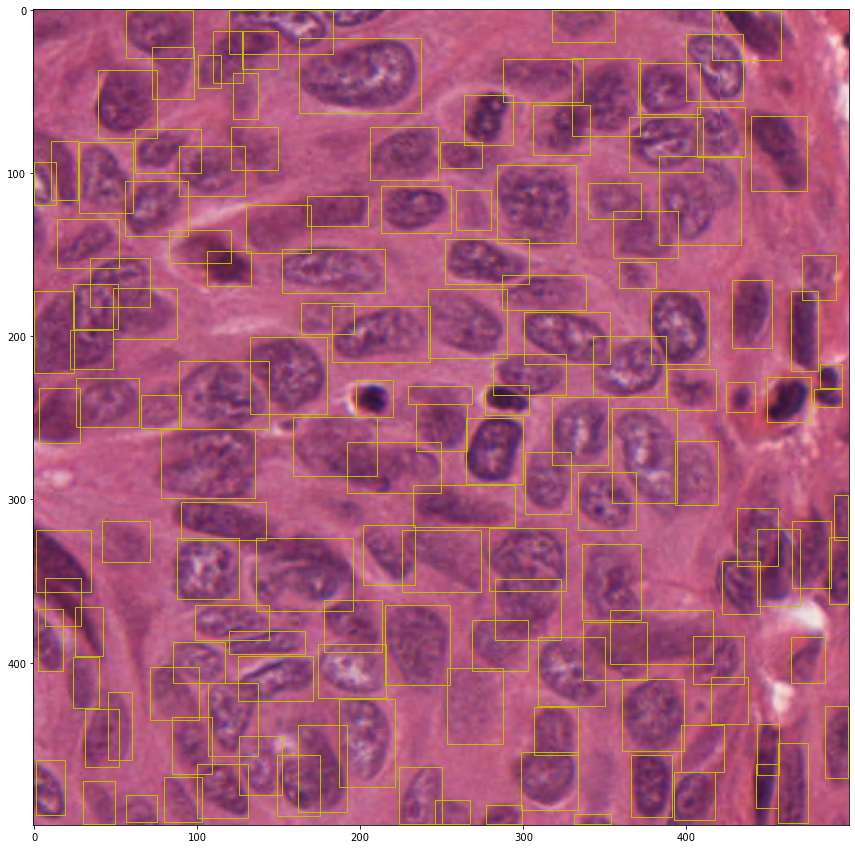

In [68]:
fig, axis = plt.subplots(1, figsize=(15, 15))
plt.imshow(bl)
for reg in scaled_annotations_per_quad["bl"]:
    axis.add_patch(reg.bounding_box.rect)
plt.show()

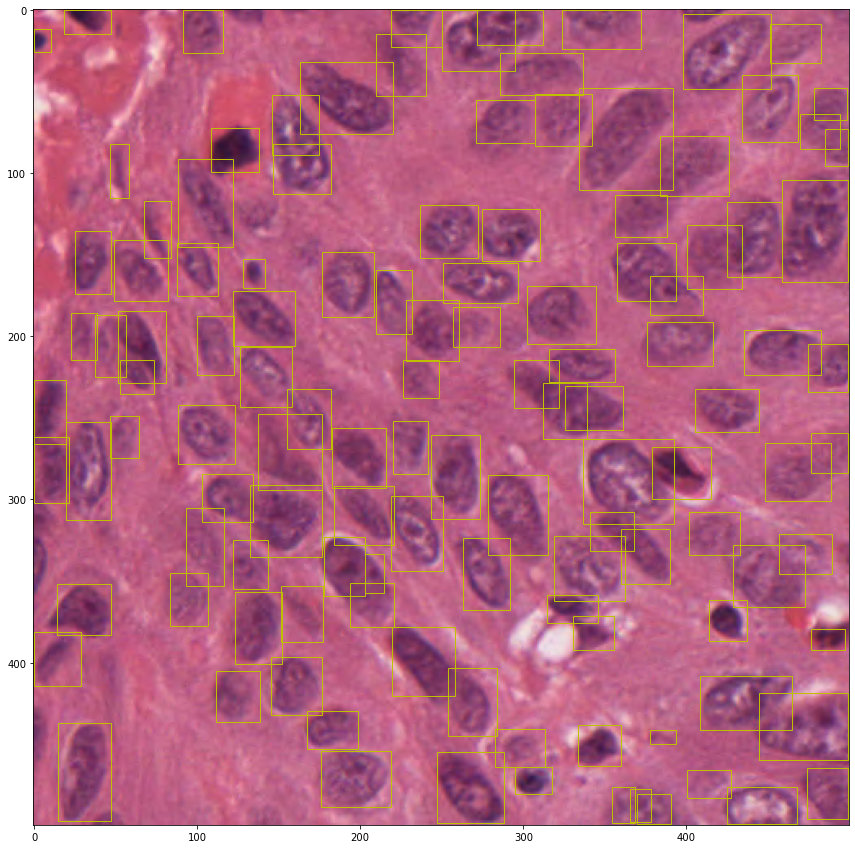

In [69]:
fig, axis = plt.subplots(1, figsize=(15, 15))
plt.imshow(br)
for reg in scaled_annotations_per_quad["br"]:
    axis.add_patch(reg.bounding_box.rect)
plt.show()

### Exercise

Try to replicate the same computation on the other pair of images, and annotations downloaded.

In [70]:
# your code here

---

## Torch Dataset

We are finally come to the definition of the `Dataset`. 

Well, in this case, the `Dataset` is the simplest step, thanks to the design and abstractions built so far. 

In other words: it does not bother at all the deep learning model whether data are at a full scale, tiled, working in quadrants.. images are preprocessed, and annotations rescaled accordingly.

From the perspective of the DL model, data is provided as (`Image`, `Annotations`) pair, no matter the scale and the resolution adopted. 
This means that no adaptation whatsoever are really necessary on the DL end, whenever we will (need to) change scale or data resolution.

In [71]:
from torch.utils.data import Dataset

@dataclass
class Sample:
    image: PIL.Image
    annotations: Sequence[Annotation]
    image_id: str
    

class AnnotatedDataTorchvision(Dataset):

    def __init__(self, collection: Sequence[Sample]):
        self.collection = collection

    def __getitem__(self, index: int):
        image = self.collection[index].image
        annotations = self.collection[index].annotations
        image_id = self.collection[index].image_id
        
        n_boxes = len(annotations)
        bboxes = torch.as_tensor([ann.bounding_box.to_tensor() for ann in annotations], 
                                 dtype=torch.float32)
        labels = torch.ones(len(annotations), dtype=torch.int64)
        areas = torch.as_tensor([ann.bounding_box.area() for ann in annotations], 
                                 dtype=torch.float32)
        iscrowd = torch.zeros((n_boxes,), dtype=torch.int64)
        target = {'boxes': bboxes, 'labels': labels, 'image_id': image_id,
                  'area': areas, 'iscrowd': iscrowd}
        return image, target

    def __len__(self):
        return len(self.collection)

**Note**: The format of the target returned, is compliant to what expected by `MaskRCNN` or `FasterRCNN` models included in `torchvision`! 

### Tiling as a Transform operator

On a complete different note, another possible requirement in Deep Learning (especially for Deep learning on Digital Pathology, and Medical Images in general) would be working on _randomly generated tiles_ extracted every epoch.

In PyTorch terms, this would easily translates into _transformers_ applied to samples extracted from a dataset. However, in this case a single subcription to the dataset won't return a _single_ item, but a _list_ of patches.

Similarly to would happen if we would use the [`FiveCrop`](https://pytorch.org/docs/stable/torchvision/transforms.html#torchvision.transforms.FiveCrop) transformer in `torchvision`.

One approach to handle with this list of patches would be to `stack` those patches into a bigger tensor (_channel_ wise) using a `Lambda` Transformer, for example.
However, if we would still keep on using the patches, we can create a different `BatchSampler` to do the collation job for us.

In the [patching_batches](./extra_patching_batches.ipynb) notebook, you will find an implementation for this use case working on `Spleen` Segmentation, and the [MONAI](https://monai.io/) project.

---